# Lab 1: Finite State Machines
## Group Members: Xuecheng Liu, Pavan Nimmagadda, Deepak Warrier

In [1]:
#Run this first; it will install required software
!pip install openfst-python

In [2]:
import openfst_python as fst
import string

## Problem 1:
Implement the morphology rules for *pluralization* and *verb past tenses* 

In [3]:
# Creates a table of word->lexical symbols
def create_lexical_tables():
  lexical_input_table = fst.SymbolTable()
  lexical_input_table.add_symbol('-')
  for char in string.ascii_lowercase:
    lexical_input_table.add_symbol(char)
  lexical_input_table.add_symbol('+N')  # Noun
  lexical_input_table.add_symbol('+V')  # Verb
  lexical_input_table.add_symbol('+l')  # Plural
  lexical_input_table.add_symbol('+i')  # Singular
  lexical_input_table.add_symbol('+a')  # Past
  lexical_input_table.add_symbol('+r')  # Present

  lexical_output_table = fst.SymbolTable()
  lexical_output_table.add_symbol('-')
  for char in string.ascii_lowercase:
    lexical_output_table.add_symbol(char)
  lexical_output_table.add_symbol('^s')  # Plural
  lexical_output_table.add_symbol('#')  # Singular
  lexical_output_table.add_symbol('^p')  # Past

  return lexical_input_table, lexical_output_table

# Creates an FST that maps from letters to the lexical level
def create_lexical_fst():
  lexical_input_table, lexical_output_table = create_lexical_tables()
  compiler = fst.Compiler(isymbols=lexical_input_table, keep_isymbols=True, osymbols=lexical_output_table, keep_osymbols=True)
  add = lambda x: print(x, file=compiler)

  for char in string.ascii_lowercase:
    add(f'0 0 {char} {char}')
  for char in string.ascii_lowercase:
    add(f'0 1 {char} {char}')
  add('1 2 +N -')
  add('1 2 +V -')
  add('2 3 +a ^p')
  add('3 6 - #')
  add('2 4 +r -')
  add('4 5 +i ^s')
  add('5 6 - #')
  add('4 6 +l #')
  add('6')

  lfst = compiler.compile()
  return lfst

In [4]:
# Creates a word acceptor, based on a given word
def create_word_fst(word):
  word_table = fst.SymbolTable()
  word_table.add_symbol('-')
  for c in string.ascii_lowercase:
    word_table.add_symbol(c)
  word_table.add_symbol('+N')  # Noun
  word_table.add_symbol('+V')  # Verb
  word_table.add_symbol('+l')  # Plural
  word_table.add_symbol('+i')  # Singular
  word_table.add_symbol('+a')  # Past
  word_table.add_symbol('+r')  # Present

  compiler = fst.Compiler(isymbols=word_table, keep_isymbols=True, keep_osymbols=True, acceptor=True)
  add = lambda x: print(x, file=compiler)

  n = 0
  special_symbol=''
  for i, c in enumerate(word):
    if special_symbol == '+':
      if word[i] == 'N':
        add(f'{n} {n + 1} +N')
        n += 1
      elif word[i] == 'V':
        add(f'{n} {n + 1} +V')
        n += 1
      elif word[i] == 'l':
        add(f'{n} {n + 1} +l')
        n += 1
      elif word[i] == 'i':
        add(f'{n} {n + 1} +i')
        n += 1
      elif word[i] == 'a':
        add(f'{n} {n + 1} +a')
        n += 1
        break
      elif word[i] == 'r':
        add(f'{n} {n + 1} +r')
        n += 1
      special_symbol = ''
    elif c in string.ascii_lowercase:
      add(f'{n} {n + 1} {c}')
      n += 1
    elif c == '+':
      special_symbol = '+'
  add(n)

  wfst = compiler.compile()
  return wfst

# Composes lexical with word FST
def lexical_to_intermediate(word):
  lfst = create_lexical_fst()
  wfst = create_word_fst(word)
  comp = fst.compose(wfst, lfst)
  
  arcs = [arc for state in comp.states() for arc in comp.arcs(state)]
  output = ''.join(str(create_lexical_tables()[1].find(arc.olabel)) for arc in arcs).replace('-', '').strip()

  return output

In [5]:
# Creates a symbol table of lexical symbols and letters
def create_surface_table():
  surface_table = fst.SymbolTable()
  surface_table.add_symbol('-')
  for char in string.ascii_lowercase:
    surface_table.add_symbol(char)
  surface_table.add_symbol('^')
  surface_table.add_symbol('#')

  return surface_table

# Given an intermedaiate form of a word, generate an acceptor for the word
def create_intermediate_fst(intermediate):
  table = create_surface_table()
  compiler = fst.Compiler(isymbols=table, keep_isymbols=True, keep_osymbols=True, acceptor=True)
  add = lambda x: print(x, file=compiler)
  n = 0
  for char in intermediate:
    add(f'{n} {n+1} {char}')
    n += 1
  add(n)
  fsta = compiler.compile()
  return fsta

In [6]:
# You could ignore this messy functions, all it does is to transit from
# intermidiate to the surface by hard-coding
def create_surface_fst():
  vowels = 'aeiu'
  specials = 'ozxsch'
  consonants = ''.join(c for c in string.ascii_lowercase if c not in vowels + specials + 'yg')
  table = create_surface_table()
  compiler = fst.Compiler(isymbols=table, osymbols=table, keep_isymbols=True, keep_osymbols=True)
  add = lambda x: print(x, file=compiler)

  for c in consonants + vowels:
    add(f'0 0 {c} {c}')
    add(f'1 0 {c} {c}')
    add(f'17 0 {c} {c}')
    add(f'30 0 {c} {c}')
  
  for c in specials:
    add(f'0 1 {c} {c}')
    add(f'17 1 {c} {c}')
    add(f'30 1 {c} {c}')
    add(f'1 1 {c} {c}')
  add(f'1 0 # -')
  
  for c in 'osxz':
    add(f'0 2 {c} {c}')
    add(f'1 2 {c} {c}')
  add(f'2 3 ^ e')
  add(f'3 4 s s')
  add(f'4 0 # -')
  
  
  add(f'0 5 c c')
  add(f'1 5 c c')
  add(f'5 28 ^ -')
  add(f'5 6 h h')
  add(f'6 7 ^ e')
  add(f'7 8 s s')
  add(f'8 0 # -')

  add(f'5 20 ^ k')
  add(f'20 21 p e')
  add(f'21 22 - d')
  add(f'22 0 # -')


  for c in consonants + 'zshxc':
    add(f'0 9 {c} {c}')
    add(f'1 9 {c} {c}')
    add(f'30 9 {c} {c}')
  add(f'9 10 y i')
  add(f'10 11 ^ e')
  add(f'11 12 s s')
  add(f'12 0 # -')

  add(f'9 23 y i')
  add(f'23 24 ^ e')
  add(f'24 25 p d')
  add(f'25 0 # -')

  for c in 'aeiou':
    add(f'0 13 {c} {c}')
    add(f'1 13 {c} {c}')
    add(f'30 13 {c} {c}')
  add(f'13 14 y y')
  add(f'14 15 ^ -')
  add(f'15 16 s s')
  add(f'16 0 # -')

  add(f'14 26 ^ e')
  add(f'26 27 p d')
  add(f'27 0 # -')


  add(f'0 17 y y')
  add(f'30 17 y y')
  add(f'17 0 # -')

  add(f'0 30 g g')
  add(f'30 17 y y')
  add(f'30 0 # -')

  add(f'30 31 ^ g')
  add(f'31 32 p e')
  add(f'32 33 - d')
  add(f'33 0 # -')


  add(f'0 28 ^ -')
  add(f'28 29 s s')
  add(f'29 0 # -')

  add(f'0 18 ^ e')
  add(f'1 18 ^ e')
  add(f'18 19 p d')
  add(f'19 0 # -')

  add(f'0 0 # -')
  add(f'0')

  f = compiler.compile()

  return f

In [7]:
# Transforms a word (plus any extra info like part-of-speech, tense, and singular/
# plural) and generate an FST via composition of the above machines
def transform(word, pos='N', tense='r', number='i'):
  intermediate = lexical_to_intermediate(word + '+' + pos + '+' + tense + '+' + number)
  i = create_intermediate_fst(intermediate)
  s = create_surface_fst()
  o = fst.compose(i, s)

  arcs = [arc for state in o.states() for arc in o.arcs(state)]
  output = ''.join(str(create_surface_table().find(arc.olabel)) for arc in arcs).replace('-', '')

  return output

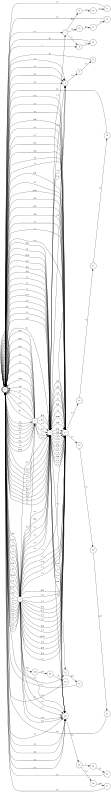

In [8]:
create_surface_fst() # Show the surface FST

Test cases for past tense verb

In [9]:
display(transform('book','V','a','s'))
display(transform('candy','V','a','s'))
display(transform('go','V','a','s'))

'booked'

'candied'

'goed'

Test cases for plural noun

In [10]:
display(transform('box','N','r','i'))
display(transform('cat','N','r','i'))
display(transform('goose','N','r','i'))

'boxes'

'cats'

'gooses'

Test cases for singular verb

In [11]:
display(transform('book','V','r','i'))
display(transform('fix','V','r','i'))
display(transform('candy','V','r','i'))

'books'

'fixes'

'candies'

### Explanations and Remarks
The final FST is produced as the producedures listed in the class by employing the 'middle man'. The only limitation of this FST is that it cannot handle irregular words because there are too many of them in the language and it is hard for us to include all of them in this machine. However, this machine does a good job in handling regular words, namely adding 's' or 'es' or change 'y' to ies and add 'ed' or 'y' to 'ied'. This is achieved by a relatively brute force way where we check the last character and then doing the corresponding transformation.<br>

Adding more states and transitions to 'create_surface_fst' will kill these limitations for irregular words but that's too much work.



## Problem 2:
Create a set of intersectable/composable FSTs that analyze the verse of *The Wellerman*

This section will start with tokenizing words from *The Wellerman* and use NLTK to detect and track the number of syllables, the stresses of each word, and parts of speech that they fall in.

We then create an FST of the words and their parts of speech

[nltk_data] Downloading package cmudict to /root/nltk_data...
[nltk_data]   Package cmudict is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[['DH', 'EH1', 'R']]
There ['EX']
[['W', 'AH1', 'N', 'S']]
once ['RB']
[['W', 'AA1', 'Z'], ['W', 'AH1', 'Z'], ['W', 'AH0', 'Z'], ['W', 'AO1', 'Z']]
was ['VBD']
[['AH0'], ['EY1']]
a ['DT']
[['SH', 'IH1', 'P']]
ship ['NN']
[['DH', 'AE1', 'T'], ['DH', 'AH0', 'T']]
that ['WDT', 'DT', 'IN']
[['P', 'UH1', 'T']]
put ['VBD']
[['T', 'UW1'], ['T', 'IH0'], ['T', 'AH0']]
to ['TO']
[['S', 'IY1']]
sea ['VB']
[['AH0', 'N', 'D'], ['AE1', 'N', 'D']]
And ['CC']
[['DH', 'AH0'], ['DH', 'AH1'], ['DH', 'IY0']]
the ['DT']
[['N', 'EY1', 'M']]
name ['NN']
[['AH1', 'V'], ['AH0', 'V']]
of ['IN']
[['DH', 'A

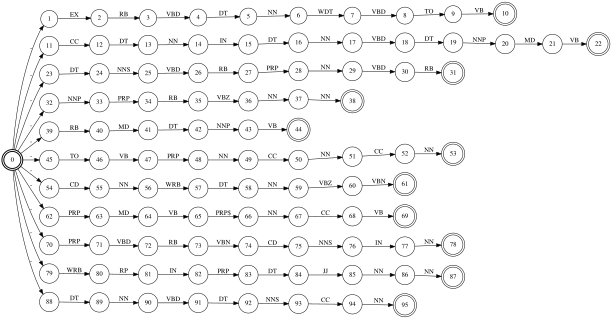

In [12]:
wellerman = """
There once was a ship that put to sea
And the name of that ship was the Billy o' Tea
The winds blew hard, her bow dipped down
Blow, me bully boys, blow (huh)
Soon may the Wellerman come
To bring us sugar and tea and rum
One day, when the tonguing' is done
We'll take our leave and go
She had not been two weeks from shore
When down on her a right whale bore
The captain called all hands and swore
He'd take that whale in tow (huh)
Soon may the Wellerman come
To bring us sugar and tea and rum
One day, when the tonguing' is done
We'll take our leave and go
Before the boat had hit the water
The whale's tail came up and caught her
All hands to the side, harpooned and fought her
When she dived down below (huh)
Soon may the Wellerman come
To bring us sugar and tea and rum
One day, when the tonguing' is done
We'll take our leave and go
No line was cut, no whale was freed
An' the captain's mind was not on greed
But he belonged to the Whaleman's creed
She took that ship in tow (huh)
Soon may the Wellerman come
To bring us sugar and tea and rum
One day, when the tonguing' is done
We'll take our leave and go
For forty days or even more (ooh)
The line went slack then tight once more
All boats were lost, there were only four
And still that whale did go
Soon may the Wellerman come
To bring us sugar and tea and rum
One day, when the tonguing' is done
We'll take our leave and go
As far as I've heard, the fight's still on
The line's not cut, and the whale's not gone
The Wellerman makes his regular call
To encourage the captain, crew and all
Soon may the Wellerman come
To bring us sugar and tea and rum
One day, when the tonguing' is done
We'll take our leave and go
Soon may the Wellerman come
To bring us sugar and tea and rum
One day, when the tonguing' is done
We'll take our leave and go
"""   #use the wellerman as our initial corpus


# Process Rule 1: There are a small range of number of syllables per line
import nltk
import nltk.data
from nltk import word_tokenize
from nltk import sent_tokenize 
 
nltk.download('cmudict')
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
from nltk.corpus import cmudict
d = cmudict.dict()
 
losts = word_tokenize(wellerman) #tokenize the words from the wellerman text
sents = sent_tokenize(wellerman) #tokenize the words from the wellerman text
valid_words = []
PoS = nltk.pos_tag(losts)
sentList = wellerman.splitlines()     #sent_list uses lines in order to better replicate the structure of the sea shanty -- sentences were either too long or didn't tokenize well
parsedPoS = []
for sent in sentList:
  w = word_tokenize(sent)
  parsedPoS.append(nltk.pos_tag(w))   #parse the parts of speech for each line into an array
part_of_speech = []
for word in losts:
  if (word.lower() in d.keys()):
    lost = [len(list(y for y in x if y[-1].isdigit())) for x in d[word.lower()]]     #get the number of syllable
    stresses = [list(y[-1] for y in x if y[-1].isdigit()) for x in d[word.lower()]]  #get the stresses from each syllable
    print(d[word.lower()])
    
    final_noises = [] #create an array of the final noises
    for pronounciation in d[word.lower()]:
      finalnoise = []
      for i, e in reversed(list(enumerate(pronounciation))):
        finalnoise.append(e)
        if (e[-1].isdigit()):#break for vowels -- the final noise for a rhyme only needs to be the 
          break
      final_noises.append(finalnoise)
      word_pos = []
    for i, x in enumerate(parsedPoS):  
      for j, p in enumerate(x):
        if p[0].lower() == word.lower():
          if (p[1] not in word_pos):
            word_pos.append(p[1])  #append the possible parts of speech for a term into an array
    print(word, word_pos)
    part_of_speech.append([word, word_pos])  #store the lists of parts of speech
    valid_words.append([word, lost, stresses, final_noises, word_pos])
  else:
    print(word + " is invalid!")

    #add the words that were meaningful and weren't in the dictionary
valid_words.append(['wellerman', [3], [['1', '0', '1']], [['N', 'AH0']], ['NNP']])
valid_words.append(['whaleman', [2], [['1', '2']], [['N', 'AH0']], ['VBN']])
valid_words.append(['tounging', [2], [['1' , '0']], [['NG', 'IH1']], ['VBG']])
valid_words.append(['harpooned', [2], [['2' , '1']], [['D', 'N', 'UH1']], ['VBN']])
wellerman_dict = []
#' '.join([str(elem) for elem in s])






for word in valid_words:
  for i, vals in enumerate(word[2]):
    for j, poses in enumerate(word[4]):
      wellerman_dict.append([word[0], 'SYL' + str(word[1][i]), '/'.join([str(elem) for elem in vals]), ''.join([str(elem) for elem in word[3][i]]), poses])
#all of the symbol tables for all the FSTs



wellerman_sylcount = fst.SymbolTable()
wellerman_sylcount.add_symbol('-')
wellerman_words = fst.SymbolTable()
wellerman_words.add_symbol('-')
wellerman_stresscount = fst.SymbolTable()
wellerman_stresscount.add_symbol('-')
wellerman_finalsyll = fst.SymbolTable()
wellerman_finalsyll.add_symbol('-')
wellerman_pos = fst.SymbolTable()
wellerman_pos.add_symbol('-')
wellerman_united = fst.SymbolTable()
wellerman_united.add_symbol('-')
wellerman_large = fst.SymbolTable()
wellerman_large.add_symbol('-')
valid_parts = []

#gets a united version of the code -- not used in the final product since we ended up using transforms in order to get this working.
def getUnited(str):
  brr = []
  for word in wellerman_dict:
    if (word[1] == str or word[2] == str or word[3] == str or word[4] == str):
      brr.append(word[1] + '!' + word[2] + '!' + word[3] + '!' + word[4])
  return brr


#add all the values to the 
valid_united_symbols=[]
for word in wellerman_dict:
  wellerman_words.add_symbol(word[0])
  wellerman_sylcount.add_symbol(word[1])
  wellerman_stresscount.add_symbol(word[2])
  wellerman_finalsyll.add_symbol(word[3])
  valid_parts.append(word[4])
  wellerman_pos.add_symbol(word[4])
  wellerman_united.add_symbol(word[1] + '!' + word[2] + '!' + word[3] + '!' + word[4])
  valid_united_symbols.append(word[1] + '!' + word[2] + '!' + word[3] + '!' + word[4])
  wellerman_large.add_symbol(word[1])  #wellerman large contains every non-word value --there should be minimal overlap between the different values that are used for each section thanks to the symbols used.
  wellerman_large.add_symbol(word[2])
  wellerman_large.add_symbol(word[3])
  wellerman_large.add_symbol(word[4])
wellerman_words.add_symbol('/n')
wellerman_united.add_symbol('/n')
wellerman_large.add_symbol('/n') # add the new line character, which isn't a word by default
print(parsedPoS)
print(part_of_speech) #prints values in order to test things out for debugging purposes
wellerman_dict        #prints the dictionary to test things out

#part_of_speech  fst
compiler=fst.Compiler(isymbols=wellerman_large,keep_isymbols=True, acceptor=True)
part_of_speech_fsts = [] #stores the fsts for each individual lines
for i, e in enumerate(parsedPoS):
  oops = 0    #counter variable is used in order to ensure that the fst is connected -- non word characters can result in the iterator being wrong.
  for j, f in enumerate(e):
    print(j)
    print(f)
    print('' + str(oops) + ' ' + str(oops+1) + ' ' + f[1]) #the variable is named oops because it was used to fix a bug and I forgot I named it that.
    if f[1] in valid_parts:
      print('' + str(oops) + ' ' + str(oops+1) + ' ' + f[1], file = compiler)
      oops = oops + 1
  print('' + str(oops), file = compiler)
  fst_a = compiler.compile() 
  part_of_speech_fsts.append(fst_a) # add the fst to the part of speec fst.
  #COMMENT THIS LINE OUT TO US PART OF SPEECH FROM MORE THAN JUST ONE VERSE
  if i > 10:
    break; # Only parse through a single verse + chorus, speeds up the initial FST creation significantly
chck = 0 
for f in part_of_speech_fsts:
  if chck == 0:
    chck = 1
  else:
    part_of_speech_fsts[0].union(f) #combine all of the lines into a single FST
print(part_of_speech_fsts[0])
compiler=fst.Compiler(isymbols=wellerman_large,keep_isymbols=True,osymbols=wellerman_words,keep_osymbols=True)
usedEdges = []
for word in wellerman_dict: #creates an FST that allows us to get the part of speech of a word
  edgestr = '0 0 ' + word[4] + ' ' + word[0]
  if edgestr not in usedEdges:
    print(edgestr) # add the edge if it wasn't added previously
    print(edgestr, file=compiler)
print('0 0 /n /n', file=compiler)
print("0", file=compiler)
pos_transducer = compiler.compile()
compiler=fst.Compiler(isymbols=wellerman_large,keep_isymbols=True,osymbols=wellerman_words,keep_osymbols=True)
print('0 1 /n /n', file=compiler) # add new lines -- prevents bugs
print('1', file=compiler)
new_line = compiler.compile()
part_of_speech_fsts[0]

# Each line in the FST represents a parsed line from the song. These were all unioned in order to ensure that they worked.

In [13]:

lines = fst.compose(part_of_speech_fsts[0].arcsort(sort_type='olabel'), pos_transducer.arcsort())
display(lines)

ex = lines.copy()
ex2 = lines
ex3 = lines
ex4 = lines
ex.concat(new_line)
ex.concat(lines.copy())
ex.concat(new_line)
ex.concat(lines.copy())
ex.concat(new_line)
ex.concat(lines.copy())
x = fst.randgen(lines).project(project_output=True)
ex  #combine four lines into a single verse. 

From here, we will create FSTs to constrict the Wellerman verses from our previous machine to follow the rules of *The Wellerman*

Note that though we do have separate code for Rule 4, the code that was used for Rule 2 actually handles Rules 2, 3, and 4

In [14]:
# Process Rule 2: The first two lines must rhyme (/ the following acceptor provides the rules for process rules 1, 2, and 3)
#this code combines process rules 2, 3, and 4 -- there's separate code for 4 but we didn't use it for the final generation

rhyme_scheme_fsts = [] #
allowed_rhymes = [] #stores the rhyme that's used for the specific section

compiler=fst.Compiler(isymbols=wellerman_large,keep_isymbols=True, acceptor=True)
list_of_ends = []
for word in wellerman_dict:
  if (word[3] not in list_of_ends):
    list_of_ends.append(word[3])
used = []

list_of_ends = list_of_ends
for word in list_of_ends[:20]: #we limited it to 20 rhyme schemes since it took too long to generate when we used more, and 20 generated interesting input
  if (word not in used):
    used.append(word)
    print(word)
    for w in list_of_ends:
      edgestr = '0 0 ' + w
      print(edgestr, file=compiler) # most of these lines follow the same basic pattern
    edgestr = '0 1 ' + word         #any number of words can be looped over until the last word of aline
    print(edgestr, file=compiler)   #the last word of a line MUST follow the rhyming scheme
    edgestr = '1 2 /n'
    print(edgestr, file=compiler)
    for w in list_of_ends:
      edgestr = '2 2 ' + w
      print(edgestr, file=compiler)
    edgestr = '2 3 ' + word
    print(edgestr, file=compiler)
    edgestr = '3 4 /n'
    print(edgestr, file=compiler)
    for w in list_of_ends:
      edgestr = '4 4 ' + w         
      print(edgestr, file=compiler)
    edgestr = '4 5 ' + word           #this line satisfies the rule 3 -- it's better if the 3rd verse rhymes
    print(edgestr, file=compiler)
    edgestr = '5 6 /n'
    print(edgestr, file=compiler)
    for w in list_of_ends:
      edgestr = '6 6 ' + w
      print(edgestr, file=compiler)
    edgestr = '6 7 ' + 'OW1'          #final verse rhymes with blow.
    print(edgestr, file=compiler)
    edgestr = '7'
    print(edgestr, file=compiler)
    rem = compiler.compile()
    rhyme_scheme_fsts.append(rem)
chck = 0
rhyming_lines = []   #combine all of the FSTs for possible rhymes into a single FST
for f in rhyme_scheme_fsts:
  rhyming_lines.append(f)
for f in rhyme_scheme_fsts:
  if chck == 0:
    chck = 1
  else:
    rhyming_lines[0].union(f)

    #rhyme_scheme_fsts[0].union(f)

rhyming_lines[0]  

compiler=fst.Compiler(isymbols=wellerman_large,keep_isymbols=True,osymbols=wellerman_words,keep_osymbols=True)
used = []  #generate a dictionary that links the final syllable to a word, and allows for conversion between the two
for word in wellerman_dict:
  edgestr = '0 0 ' + word[3] + ' ' + word[0]
  if edgestr not in used:
    print(edgestr)
    print(edgestr, file=compiler)
    used.append(edgestr)
print('0 0 /n /n', file=compiler)  # add the new line character
print('0 0 - -', file=compiler)
print('0', file=compiler)
rhymes = compiler.compile()

rhyme_lines = fst.compose(rhyming_lines[0].arcsort(), rhymes.arcsort()) #compose these into a single FST
rhyme_lines

REH1
SNAH1
ZAA1
ZAH1
ZAH0
ZAO1
AH0
EY1
PIH1
TAE1
TAH0
TUH1
UW1
IH0
IY1
DNAH0
DNAE1
AH1
IY0
MEY1
0 0 REH1 There
0 0 SNAH1 once
0 0 ZAA1 was
0 0 ZAH1 was
0 0 ZAH0 was
0 0 ZAO1 was
0 0 AH0 a
0 0 EY1 a
0 0 PIH1 ship
0 0 TAE1 that
0 0 TAH0 that
0 0 TUH1 put
0 0 UW1 to
0 0 IH0 to
0 0 AH0 to
0 0 IY1 sea
0 0 DNAH0 And
0 0 DNAE1 And
0 0 AH0 the
0 0 AH1 the
0 0 IY0 the
0 0 MEY1 name
0 0 VAH1 of
0 0 VAH0 of
0 0 IY0 Billy
0 0 OW1 o
0 0 IY1 Tea
0 0 AH0 The
0 0 AH1 The
0 0 IY0 The
0 0 ZDNIH1 winds
0 0 ZDNAY1 winds
0 0 UW1 blew
0 0 DRAA1 hard
0 0 ER0 her
0 0 ER1 her
0 0 AW1 bow
0 0 OW1 bow
0 0 TPIH1 dipped
0 0 NAW1 down
0 0 OW1 Blow
0 0 IY1 me
0 0 IY0 bully
0 0 ZOY1 boys
0 0 OW1 blow
0 0 AH1 huh
0 0 NUW1 Soon
0 0 EY1 may
0 0 MAH1 come
0 0 UW1 To
0 0 IH0 To
0 0 AH0 To
0 0 NGIH1 bring
0 0 SAH1 us
0 0 SEH1 us
0 0 ER0 sugar
0 0 DNAH0 and
0 0 DNAE1 and
0 0 IY1 tea
0 0 MAH1 rum
0 0 NAH1 One
0 0 EY1 day
0 0 NEH1 when
0 0 NIH1 when
0 0 ZIH1 is
0 0 ZIH0 is
0 0 NAH1 done
0 0 IY1 We
0 0 KEY1 take
0 0 ER0 our
0 

In [21]:
# display(ex, rhyme_lines) #This section and the next section show the two FSTs that we need to combine. This one is parts of speech and rhyming schemes

Here we compose our line rhyming machine $(\text{Rhyming Syllables} -> \text{words})$ and our general verse structure machine $(\text{words} -> \text{Parts of Speech})$, and then intersect that *full* machine $(\text{Rhyming Syllables} -> \text{Parts of Speech})$ with our machine that tracks parts of speech.

Using this final machine, we intersect it with our rhyming_lines machine to get back the words that were lost in the composition.

In [16]:
#gets an FST that combines the the rhyming scheme with the parts of speech -- used to convert the rhyming schems to meaningful outputs
full = fst.compose(rhyme_lines.arcsort(sort_type='olabel'), ex.copy().invert().arcsort())  
#get a proper word of the proper part of speech from the pos transducer
temp = fst.compose(full.arcsort(sort_type='olabel'), pos_transducer.arcsort())
#get something that contains all the possible part of speech things as words
temp = temp.project(project_output=True)
#get something that gets all the possible rhyme lines as words
temp1 = rhyme_lines.project(project_output=True)

Now to generate some *Wellerman* verses!

In [17]:
# This block takes some time to run, so please run with caution...#
###################################################################
intersect = fst.intersect(temp, temp1)  #get all the possible outputs
intersect.rmepsilon()   #remove epsilon values
out = fst.randgen(intersect)  #generate an output
for i in out.states(): 
  for j in out.arcs(i):
    print(out.input_symbols().find(j.olabel))  #Print the values from each label

Blow
he
once
boys
rum
tea
/n
wellerman
I
bully
boys
ooh
tea
/n
She
dipped
As
gone
four
winds
For
Tea
/n
no
greed
did
all
days
But
tow


0 0 REH1 There
0 0 SNAH1 once
0 0 ZAA1 was
0 0 ZAH1 was
0 0 ZAH0 was
0 0 ZAO1 was
0 0 AH0 a
0 0 EY1 a
0 0 PIH1 ship
0 0 TAE1 that
0 0 TAE1 that
0 0 TAE1 that
0 0 TAH0 that
0 0 TAH0 that
0 0 TAH0 that
0 0 TUH1 put
0 0 UW1 to
0 0 IH0 to
0 0 AH0 to
0 0 IY1 sea
0 0 DNAH0 And
0 0 DNAE1 And
0 0 AH0 the
0 0 AH1 the
0 0 IY0 the
0 0 MEY1 name
0 0 VAH1 of
0 0 VAH0 of
0 0 TAE1 that
0 0 TAE1 that
0 0 TAE1 that
0 0 TAH0 that
0 0 TAH0 that
0 0 TAH0 that
0 0 PIH1 ship
0 0 ZAA1 was
0 0 ZAH1 was
0 0 ZAH0 was
0 0 ZAO1 was
0 0 AH0 the
0 0 AH1 the
0 0 IY0 the
0 0 IY0 Billy
here!
0 0 OW1 o
0 0 IY1 Tea
0 0 IY1 Tea
0 0 AH0 The
0 0 AH1 The
0 0 IY0 The
0 0 ZDNIH1 winds
0 0 ZDNAY1 winds
0 0 UW1 blew
0 0 DRAA1 hard
0 0 ER0 her
0 0 ER0 her
0 0 ER1 her
0 0 ER1 her
0 0 AW1 bow
here!
0 0 OW1 bow
0 0 TPIH1 dipped
0 0 NAW1 down
0 0 NAW1 down
here!
0 0 OW1 Blow
here!
0 0 OW1 Blow
0 0 IY1 me
0 0 IY0 bully
0 0 ZOY1 boys
here!
0 0 OW1 blow
here!
0 0 OW1 blow
0 0 AH1 huh
0 0 NUW1 Soon
0 0 EY1 may
0 0 AH0 the
0 0 AH1 the
0 

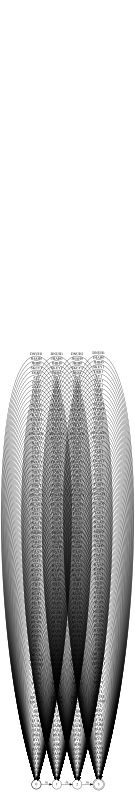

In [18]:
# Process Rule 4: The last line must rhyme with "blow" -- this code works well for the blow 
compiler=fst.Compiler(isymbols=wellerman_large,keep_isymbols=True,osymbols=wellerman_words,keep_osymbols=True)
used = []
for word in wellerman_dict:
  if (word[3] == 'OW1'):  #used for debugging
    print('here!')
  edgestr = '0 0 ' + word[3] + ' ' + word[0]
  print(edgestr)
  print(edgestr, file=compiler)
  print("0", file=compiler)
print('0 0 /n /n', file=compiler)
print('0', file=compiler)
rhymes = compiler.compile()
compiler=fst.Compiler(isymbols=wellerman_large,keep_isymbols=True, acceptor=True)
edgestr = '0 0 OW1' #guarantees that there's a proper edge in the graph.
if edgestr not in usedEdges:
  print(edgestr, file=compiler)
edgestr = '0 1 ' + '/n'     #end first line 
print(edgestr, file=compiler)
for word in wellerman_dict:
  edgestr = '1 1 ' + word[3]   # any scheme can be used in the 2nd line
  if edgestr not in usedEdges:
    print(edgestr, file=compiler)
edgestr = '1 2 ' + '/n'
print(edgestr, file=compiler)
edgestr = '2'
print(edgestr, file=compiler)
end_must_rhyme = compiler.compile()
for word in wellerman_dict:
  edgestr = '2 2 ' + word[3]  # any scheme can be used in the 2nd line
  if edgestr not in usedEdges:
    print(edgestr, file=compiler)
edgestr = '2 3 ' + '/n'
print(edgestr, file=compiler)
for word in wellerman_dict:
  edgestr = '3 3 ' + word[3]
  if edgestr not in usedEdges:
    print(edgestr, file=compiler)
edgestr = '3 4 ' + '/n'
print(edgestr, file=compiler)
for word in wellerman_dict:
  edgestr = '4 4 ' + word[3]
  if edgestr not in usedEdges:
    print(edgestr, file=compiler)
edgestr = '4 5 ' + 'OW1'     #final line needs to end with OW1
print(edgestr, file=compiler)
edgestr = '5'
print(edgestr, file=compiler)
end_must_rhyme = compiler.compile()

usedEdges = []


#smaller test version used for debugging purposes -- large parts of this do the same thing as previous versions.
for word in wellerman_dict:
    
    edgestr = '0 0 ' + word[3]
    if edgestr not in usedEdges:
      print(edgestr, file=compiler)
    usedEdges.append(edgestr)
edgestr = '0 1 ' + '/n'
print(edgestr, file=compiler)
for word in wellerman_dict:
  edgestr = '1 1 ' + word[3]
  if edgestr not in usedEdges:
    print(edgestr, file=compiler)
  usedEdges.append(edgestr)
edgestr = '1 2 ' + '/n'
print(edgestr, file=compiler)
for word in wellerman_dict:
  edgestr = '2 2 ' + word[3]
  if edgestr not in usedEdges:
    print(edgestr, file=compiler)
  usedEdges.append(edgestr)
edgestr = '2 3 ' + '/n'
print(edgestr, file=compiler)
for word in wellerman_dict:
  edgestr = '3 3 ' + word[3]
  if edgestr not in usedEdges:
    print(edgestr, file=compiler)
  usedEdges.append(edgestr)

edgestr = '3'
print(edgestr, file=compiler)
end_must_rhyme = compiler.compile() #this version adds the final word that rhymes with blow as a separate FST, which is Concatenated
compiler=fst.Compiler(isymbols=wellerman_large,keep_isymbols=True, acceptor=True)
edgestr = '0 1 OW1'
print(edgestr, file=compiler)
edgestr = '1'
print(edgestr, file=compiler)
with_blow = compiler.compile()
lines = fst.compose(end_must_rhyme, rhymes)
blimes = fst.compose(with_blow, rhymes)
lines.concat(blimes)
# fst.randgen(lines)
end_must_rhyme

In [19]:
#repeat of previous code used to analyze code

verse = """She had not been two weeks from shore
When down on her a right whale bore
The captain called all hands and swore
He take that whale in tow (huh)"""
verse = verse.replace('\n', ' /n ')
verse = ''.join([v for v in verse if v == ' ' or v == '/' or v in string.ascii_letters])
verse = [x for x in verse.split(' ')]

firstVerse = fst.Compiler(isymbols=wellerman_words, osymbols=wellerman_words, keep_isymbols=True, keep_osymbols=True)

n = 0
for w in verse[0:]:
  print(f"{n} {n+1} {w} {w}", file=firstVerse)
  n += 1
print(f"{n}", file=firstVerse)
firstVerse = firstVerse.compile()
display(firstVerse)
fst.compose(lines, firstVerse)

33

'He'

### Remarks
While our method for generating *Wellerman* verses was a bit roundabout, it still got the job done. The overall design starts with the `ex` transducer tracking overall verse design, follwed by a composition with a machine that constricts rhyming rules.

For fun, here are some of the other phrases that were generated during developed:
```
the sugar put The winds And ship
to come me Blow and blow And ship
To come me blow and day and ship
the Blow blew The winds and bow
```
```
a sugar dipped The winds and ship
To sea us rum And sugar and ship
that Tea blew The winds And ship
blow us once boys ship Blow
```
```
To sea us tea and tea And Tea
to tea us day And ship And tea
us o come a name of Tea tea 
when me put bully that blow
```

